In [16]:
# Autoreload and Imports
from IPython import get_ipython
ip = get_ipython()
ip.magic("reload_ext autoreload")  # these will enable module autoreloading
ip.magic("autoreload 2")
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from src import pre_process
from src import constants
import json

In [17]:
#Get Train Data
train = pre_process.getTrain()
train.head()

,ID,Loan Amount,Funded Amount,Funded Amount Investor,Term,Batch Enrolled,Interest Rate,Grade,Sub Grade,Employment Duration,...,Recoveries,Collection Recovery Fee,Collection 12 months Medical,Application Type,Last week Pay,Accounts Delinquent,Total Collection Amount,Total Current Balance,Total Revolving Credit Limit,Loan Status
0,65087372,10000.0,32236.0,12329.36286,59,BAT2522922,11.135007,B,C4,MORTGAGE,...,2.498291,0.793724,0,INDIVIDUAL,49,0,31.0,311301.0,6619,False
1,1450153,3609.0,11940.0,12191.99692,59,BAT1586599,12.237563,C,D3,RENT,...,2.377215,0.974821,0,INDIVIDUAL,109,0,53.0,182610.0,20885,False
2,1969101,28276.0,9311.0,21603.22455,59,BAT2136391,12.545884,F,D4,MORTGAGE,...,4.316277,1.020075,0,INDIVIDUAL,66,0,34.0,89801.0,26155,False
3,6651430,11170.0,6954.0,17877.15585,59,BAT2428731,16.731201,C,C3,MORTGAGE,...,0.107020,0.749971,0,INDIVIDUAL,39,0,40.0,9189.0,60214,False
4,14354669,16890.0,13226.0,13539.92667,59,BAT5341619,15.008300,C,D4,MORTGAGE,...,1294.818751,0.368953,0,INDIVIDUAL,18,0,430.0,126029.0,22579,False


In [18]:
# Null values
train.isna().sum()

ID                              0
Loan Amount                     0
Funded Amount                   0
Funded Amount Investor          0
Term                            0
Batch Enrolled                  0
Interest Rate                   0
Grade                           0
Sub Grade                       0
Employment Duration             0
Home Ownership                  0
Verification Status             0
Payment Plan                    0
Loan Title                      0
Debit to Income                 0
Delinquency - two years         0
Inquires - six months           0
Open Account                    0
Public Record                   0
Revolving Balance               0
Revolving Utilities             0
Total Accounts                  0
Initial List Status             0
Total Received Interest         0
Total Received Late Fee         0
Recoveries                      0
Collection Recovery Fee         0
Collection 12 months Medical    0
Application Type                0
Last week Pay 

In [19]:
#Missing Values
pre_process.findMissingValues(train)

[]

In [20]:
outlier_indexes = pre_process.getOutlierIndexByZScore(train, constants.columnDataTypes,5)
with open('./data/processed/outlier_indexes.txt', 'w') as f:
    print(outlier_indexes, file=f)

0        65087372
1         1450153
2         1969101
3         6651430
4        14354669
           ...   
67458    16164945
67459    35182714
67460    16435904
67461     5300325
67462    65443173
Name: ID, Length: 67463, dtype: int64
0        10000.0
1         3609.0
2        28276.0
3        11170.0
4        16890.0
          ...   
67458    13601.0
67459     8323.0
67460    15897.0
67461    16567.0
67462    15353.0
Name: Loan Amount, Length: 67463, dtype: float64
0        32236.0
1        11940.0
2         9311.0
3         6954.0
4        13226.0
          ...   
67458     6848.0
67459    11046.0
67460    32921.0
67461     4975.0
67462    29875.0
Name: Funded Amount, Length: 67463, dtype: float64
0        12329.36286
1        12191.99692
2        21603.22455
3        17877.15585
4        13539.92667
            ...     
67458    13175.28583
67459    15637.46301
67460    12329.45775
67461    21353.68465
67462    14207.44860
Name: Funded Amount Investor, Length: 67463, dtype: float64

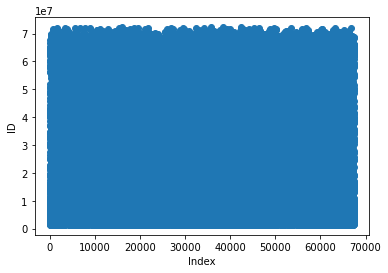

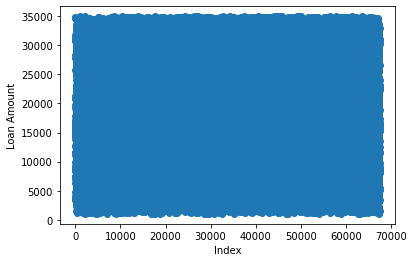

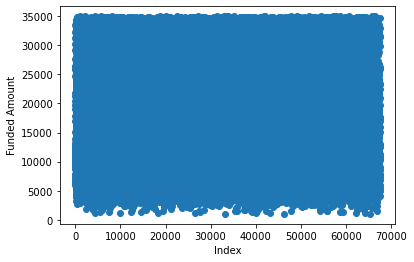

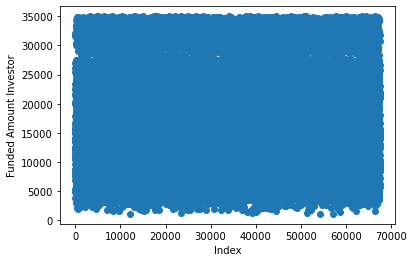

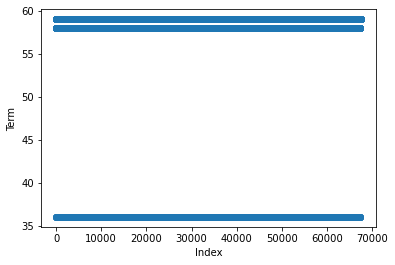

...

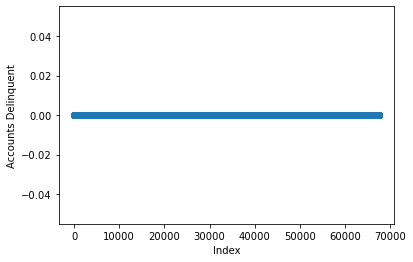

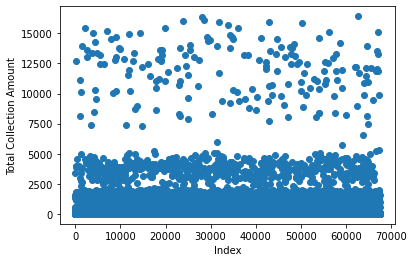

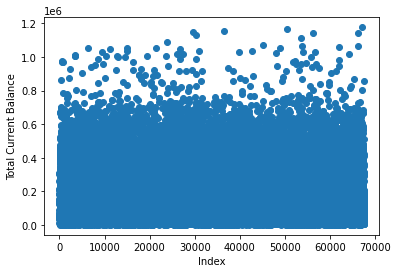

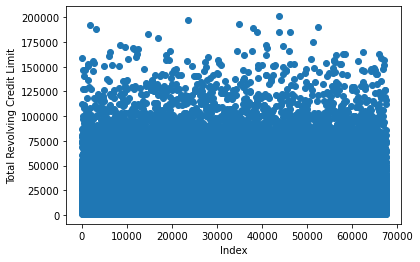

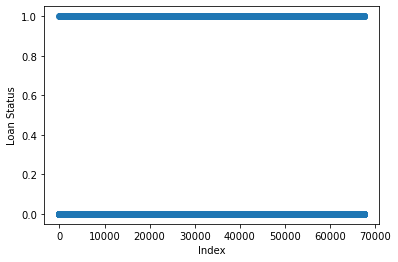

In [21]:
pre_process.plot_data(train)

In [22]:
pre_process.getParallelGraph(train.loc[train['Loan Status'] == False])

In [23]:
pre_process.getParallelGraph(train.loc[train['Loan Status'] == True])

In [24]:
train_nums = pre_process.getNumericalData(train)

# Split train data
train_set, test_set = train_test_split(train_nums, test_size=0.2, random_state=42)

train_x = train_set.drop(columns=['Loan Status'])
train_y = train_set['Loan Status']

test_x = test_set.drop(columns=['Loan Status'])
test_y = test_set['Loan Status']

In [25]:
# Random Forest
rf = RandomForestClassifier()
rf.fit(train_x, train_y)

# Predictions
preds = rf.predict(test_x)

# Performance
accuracy_score(test_y, preds)

0.9097309716149115

In [ ]:
# 90% not bad